<a href="https://colab.research.google.com/github/thyyl/Machine-Learning-Voting/blob/main/Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Upload data 

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving biodeg.csv to biodeg.csv


### Import library

In [ ]:
import collections
import sys
import os
import io
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display, HTML, Image
%matplotlib inline

from plotly import tools
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.figure_factory as ff
import plotly.offline as py
import plotly.graph_objs as go
import plotly.tools as tls
py.init_notebook_mode(connected=True)

import warnings
warnings.filterwarnings('ignore')

In [ ]:
SEED = 42
np.random.seed(SEED)

In [ ]:
df = pd.read_csv(io.BytesIO(uploaded['biodeg.csv']), sep=';')
df_name = df.columns
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1055 entries, 0 to 1054
Data columns (total 42 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   SpMax_L             1055 non-null   float64
 1   J_Dz(e)             1055 non-null   float64
 2   nHM                 1055 non-null   int64  
 3   F01[N-N]            1055 non-null   int64  
 4   F04[C-N]            1055 non-null   int64  
 5   NssssC              1055 non-null   int64  
 6   nCb-                1055 non-null   int64  
 7   C%                  1055 non-null   float64
 8   nCp                 1055 non-null   int64  
 9   nO                  1055 non-null   int64  
 10  F03[C-N]            1055 non-null   int64  
 11  SdssC               1055 non-null   float64
 12  HyWi_B(m)           1055 non-null   float64
 13  LOC                 1055 non-null   float64
 14  SM6_L               1055 non-null   float64
 15  F03[C-O]            1055 non-null   int64  
 16  Me    

Analyse Data


*   There is no null value in data set
*   There is no time-related data
*   The experimental_class, or target variable is type object





Encoded target varaible

In [ ]:
from sklearn.preprocessing import LabelEncoder 

label_encoder = LabelEncoder()
y_encoded = df['experimental_class']
y_encoded = label_encoder.fit_transform(y_encoded)
df.drop('experimental_class', axis=1)
df['experimental_class'] = y_encoded

In [ ]:
df.describe()

,SpMax_L,J_Dz(e),nHM,F01[N-N],F04[C-N],NssssC,nCb-,C%,nCp,nO,F03[C-N],SdssC,HyWi_B(m),LOC,SM6_L,F03[C-O],Me,Mi,nN-N,nArNO2,nCRX3,SpPosA_B(p),nCIR,B01[C-Br],B03[C-Cl],N-073,SpMax_A,Psi_i_1d,B04[C-Br],SdO,TI2_L,nCrt,C-026,F02[C-N],nHDon,SpMax_B(m),Psi_i_A,nN,SM6_B(m),nArCOOR,nX
count,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000,1055.000000
mean,4.782644,3.069508,0.716588,0.042654,0.980095,0.290047,1.646445,37.055640,1.376303,1.803791,1.436967,-0.197129,3.476844,1.350716,9.937381,3.630332,1.013302,1.131106,0.008531,0.073934,0.029384,1.238727,1.405687,0.039810,0.147867,0.031280,2.215641,-0.001206,0.026540,8.780510,2.668344,0.129858,0.883412,1.274882,0.961137,3.918240,2.558417,0.686256,8.629492,0.051185,0.723223
std,0.546916,0.831308,1.462452,0.256010,2.332955,1.073771,2.224822,9.144466,1.963521,1.775435,3.116577,0.769662,0.584150,0.786166,0.928678,4.457243,0.046494,0.030143,0.101802,0.317475,0.217997,0.096466,4.788542,0.195606,0.355137,0.199544,0.226131,0.158928,0.160812,11.895889,2.096607,0.644057,1.520467,2.273994,1.257013,0.999602,0.642765,1.090389,1.241986,0.318970,2.239286
min,2.000000,0.803900,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-5.256000,1.544000,0.000000,4.174000,0.000000,0.957000,1.022000,0.000000,0.000000,0.000000,0.863000,0.000000,0.000000,0.000000,0.000000,1.000000,-1.099000,0.000000,0.000000,0.444000,0.000000,0.000000,0.000000,0.000000,2.267000,1.467000,0.000000,4.917000,0.000000,0.000000
25%,4.481000,2.502750,0.000000,0.000000,0.000000,0.000000,0.000000,30.450000,0.000000,0.000000,0.000000,-0.191000,3.105000,0.875000,9.533000,0.000000,0.983000,1.116000,0.000000,0.000000,0.000000,1.182000,0.000000,0.000000,0.000000,0.000000,2.101000,-0.008000,0.000000,0.000000,1.446500,0.000000,0.000000,0.000000,0.000000,3.487500,2.103000,0.000000,7.991000,0.000000,0.000000
50%,4.828000,3.046300,0.000000,0.000000,0.000000,0.000000,1.000000,37.500000,1.000000,2.000000,0.000000,0.000000,3.442000,1.187000,10.039000,2.000000,1.003000,1.130000,0.000000,0.000000,0.000000,1.243000,1.000000,0.000000,0.000000,0.000000,2.247000,0.000000,0.000000,0.000000,2.052000,0.000000,0.000000,0.000000,1.000000,3.726000,2.458000,0.000000,8.499000,0.000000,0.000000
75%,5.125000,3.437650,1.000000,0.000000,1.000000,0.000000,3.000000,43.400000,2.000000,3.000000,2.000000,0.000000,3.825500,1.705000,10.514500,6.000000,1.029000,1.143000,0.000000,0.000000,0.000000,1.296000,2.000000,0.000000,0.000000,0.000000,2.358000,0.005000,0.000000,12.465000,3.146000,0.000000,1.000000,2.000000,2.000000,3.987000,2.870500,1.000000,9.020500,0.000000,0.000000
max,6.496000,9.177500,12.000000,3.000000,36.000000,13.000000,18.000000,60.700000,24.000000,12.000000,44.000000,4.722000,5.701000,4.491000,12.609000,40.000000,1.311000,1.377000,2.000000,3.000000,3.000000,1.641000,147.000000,1.000000,1.000000,3.000000,2.859000,1.073000,1.000000,71.167000,17.537000,8.000000,12.000000,18.000000,7.000000,10.695000,5.825000,8.000000,14.700000,4.000000,27.000000


### Data visualization

In [ ]:
 g = sns.pairplot(df, hue="experimental_class", palette="husl")

It seems that the data suffer from outliers

### Data quality and missing value assessment

In [ ]:
plt.rc("font", size=14)
sns.set(style="white")
sns.set(style="whitegrid", color_codes=True)

In [ ]:
df.isnull().sum()

SpMax_L               0
J_Dz(e)               0
nHM                   0
F01[N-N]              0
F04[C-N]              0
NssssC                0
nCb-                  0
C%                    0
nCp                   0
nO                    0
F03[C-N]              0
SdssC                 0
HyWi_B(m)             0
LOC                   0
SM6_L                 0
F03[C-O]              0
Me                    0
Mi                    0
nN-N                  0
nArNO2                0
nCRX3                 0
SpPosA_B(p)           0
nCIR                  0
B01[C-Br]             0
B03[C-Cl]             0
N-073                 0
SpMax_A               0
Psi_i_1d              0
B04[C-Br]             0
SdO                   0
TI2_L                 0
nCrt                  0
C-026                 0
F02[C-N]              0
nHDon                 0
SpMax_B(m)            0
Psi_i_A               0
nN                    0
SM6_B(m)              0
nArCOOR               0
nX                    0
experimental_cla

There is no missing data or null value in the datasets. There is no need to replace the data.

### Exploratory Data Analysis

In [ ]:
def OutLiersBox(df, nameOfFeature):
  trace0 = go.Box(
    y = df[nameOfFeature],
    name = "All Points",
    jitter = 0.3,
    pointpos = -1.8,
    boxpoints = 'all',
    marker = dict(color = 'rgb(7,40,89)'),
    line = dict(color = 'rgb(7,40,89)'))

  trace1 = go.Box(
    y = df[nameOfFeature],
    name = "Only Whiskers",
    boxpoints = False,
    marker = dict(color = 'rgb(9,56,125)'),
    line = dict(color = 'rgb(9,56,125)'))

  trace2 = go.Box(
    y = df[nameOfFeature],
    name = "Suspected Outliers",
    boxpoints = 'suspectedoutliers',
    marker = dict(
      color = 'rgb(8,81,156)',
      outliercolor = 'rgba(219, 64, 82, 0.6)',
      line = dict(
        outliercolor = 'rgba(219, 64, 82, 0.6)',
        outlierwidth = 2)),
    line = dict(color = 'rgb(8,81,156)'))

  trace3 = go.Box(
    y = df[nameOfFeature],
    name = "Whiskers and Outliers",
    boxpoints = 'outliers',
    marker = dict(color = 'rgb(107,174,214)'),
    line = dict(color = 'rgb(107,174,214)'))

  data = [trace0, trace1, trace2, trace3]

  layout = go.Layout(
    title = "{} Outliers".format(nameOfFeature),
    template = 'plotly_white'
  )

  fig = go.Figure(data=data, layout=layout)
  iplot(fig, filename = "Outliers")

In [ ]:
def plotBarCat(df, feature, left, right):
  plt.figure(figsize=(30, 5))
  ax = sns.kdeplot(df[feature][df.experimental_class == 'RB'], color="darkturquoise", shade=True)
  sns.kdeplot(df[feature][df.experimental_class == 'NRB'], color="lightcoral", shade=True)
  plt.legend(['RB', 'NRB'])
  plt.title('Density Plot of ' + feature + ' for RB Class and NRB Class')
  ax.set(xlabel=feature)
  plt.xlim(left, right)
  plt.show()

In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

SpMax_L: Leading eigenvalue from Laplace matrix

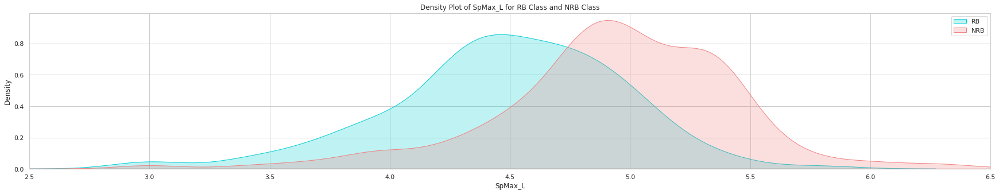

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'SpMax_L', 2.5, 6.5)
OutLiersBox(df, 'SpMax_L')

J_Dz(e): Balaban-like index from Barysz matrix weighted by Sanderson electronegativity

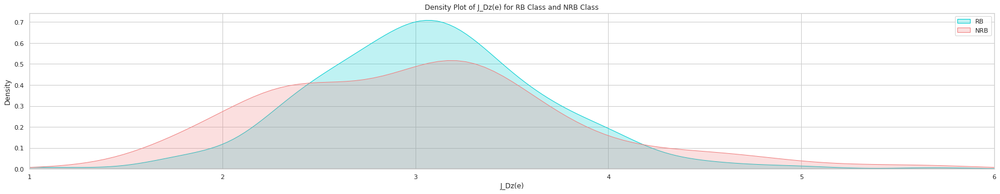

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'J_Dz(e)', 1, 6)
OutLiersBox(df, 'J_Dz(e)')

nHM: Number of heavy atoms

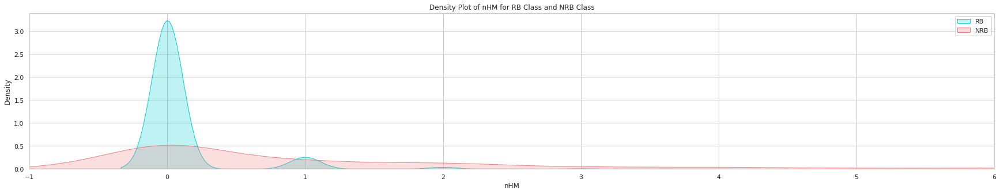

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nHM', -1, 6)
OutLiersBox(df, 'nHM')

F01[N-N]: Frequency of N-N at topological distance 1

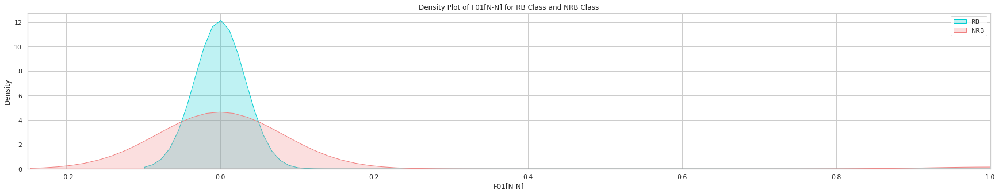

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'F01[N-N]', -0.25, 1)
OutLiersBox(df, 'F01[N-N]')

F04[C-N]: Frequency of C-N at topological distance 4

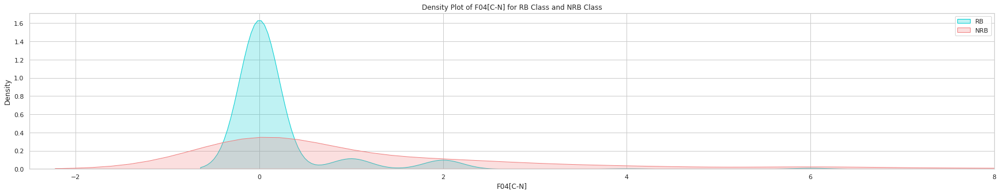

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'F04[C-N]', -2.5, 8)
OutLiersBox(df, 'F04[C-N]')

NssssC: Number of atoms of type ssssC

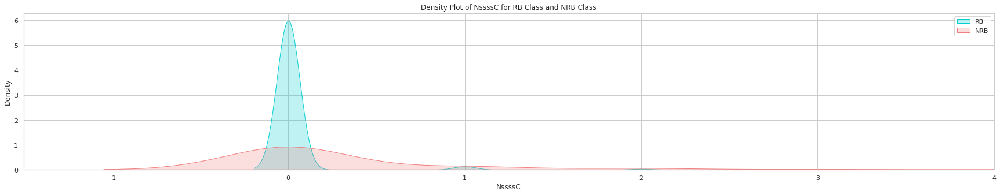

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'NssssC', -1.5, 4)
OutLiersBox(df, 'NssssC')

nCb-: Number of substituted benzene C(sp2)v

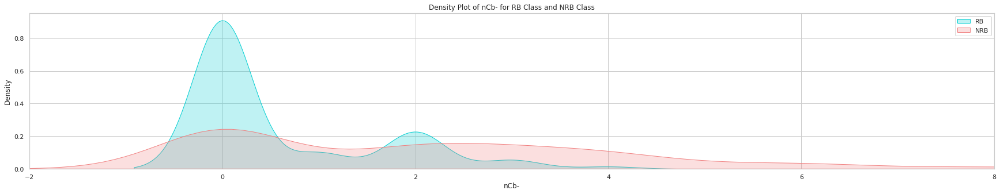

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nCb-', -2, 8)
OutLiersBox(df, 'nCb-')

C%: Percentage of C atoms

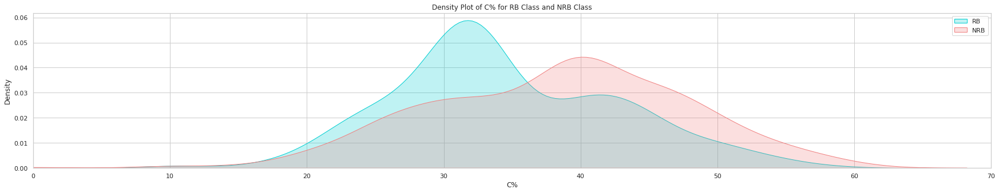

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'C%', 0, 70)
OutLiersBox(df, 'C%')

nCp: Number of terminal primary C(sp3)

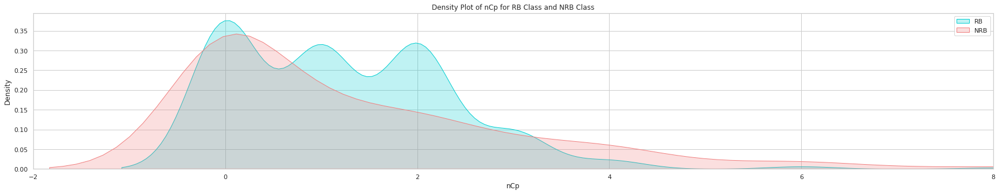

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nCp', -2, 8)
OutLiersBox(df, 'nCp')

nO: Number of oxygen atoms

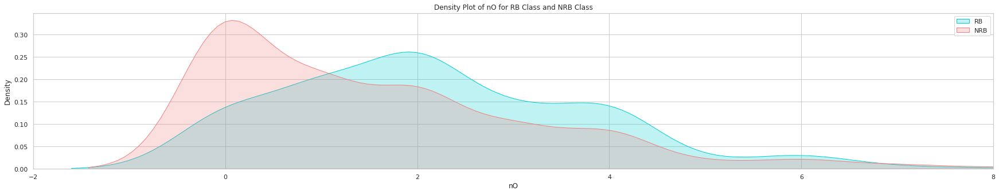

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nO', -2, 8)
OutLiersBox(df, 'nO')

F03[C-N]: Frequency of C-N at topological distance 3

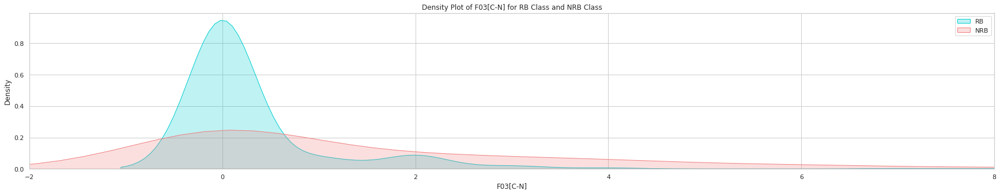

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'F03[C-N]', -2, 8)
OutLiersBox(df, 'F03[C-N]')

SdssC: Sum of dssC E-states

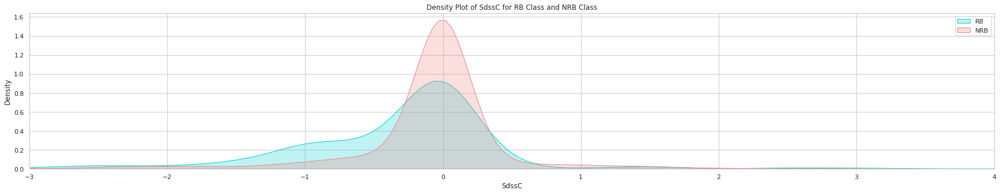

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'SdssC', -3, 4)
OutLiersBox(df, 'SdssC')

HyWi_B(m): Hyper-Wiener-like index (log function) from Burden matrix weighted by mass

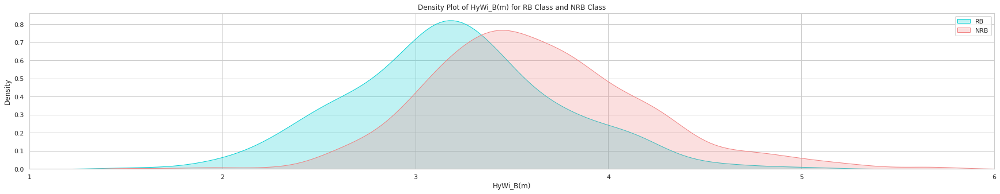

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'HyWi_B(m)', 1, 6)
OutLiersBox(df, 'HyWi_B(m)')

LOC: Lopping centric index

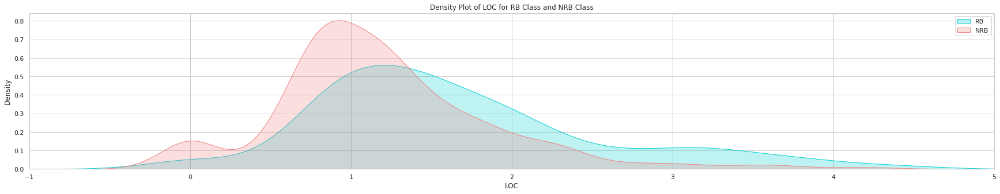

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'LOC', -1, 5)
OutLiersBox(df, 'LOC')

SM6_L: Spectral moment of order 6 from Laplace matrix

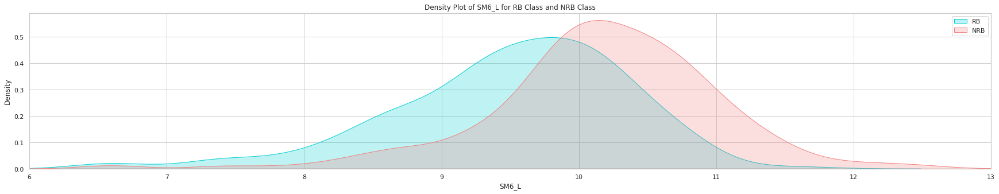

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'SM6_L', 6, 13)
OutLiersBox(df, 'SM6_L')

F03[C-O]: Frequency of C - O at topological distance 3

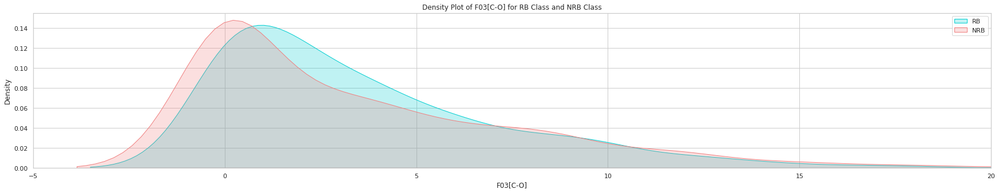

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'F03[C-O]', -5, 20)
OutLiersBox(df, 'F03[C-O]')

Me: Mean atomic Sanderson electronegativity (scaled on Carbon atom)

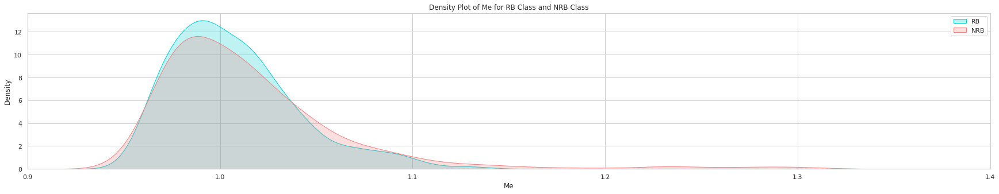

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'Me', 0.9, 1.4)
OutLiersBox(df, 'Me')

Mi: Mean first ionization potential (scaled on Carbon atom)

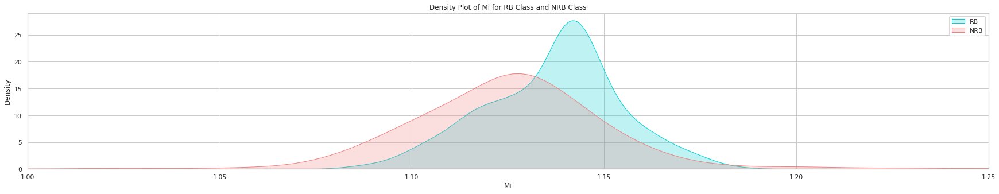

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'Mi', 1, 1.25)
OutLiersBox(df, 'Mi')

nN-N: Number of N hydrazines

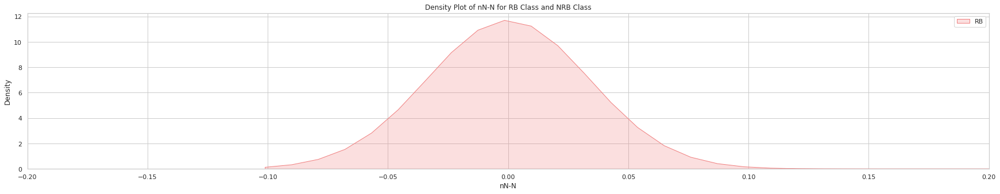

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nN-N', -0.2, 0.2)
OutLiersBox(df, 'nN-N')

nArNO2: Number of nitro groups (aromatic)

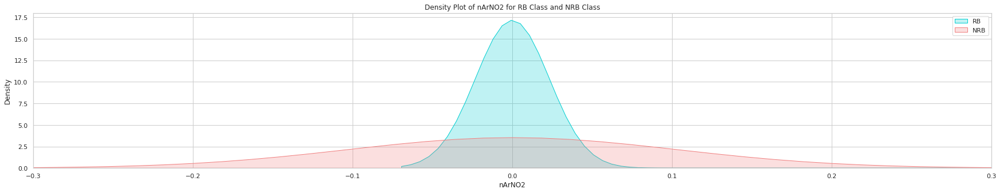

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nArNO2', -0.3, 0.3)
OutLiersBox(df, 'nArNO2')

nCRX3: Number of CRX3

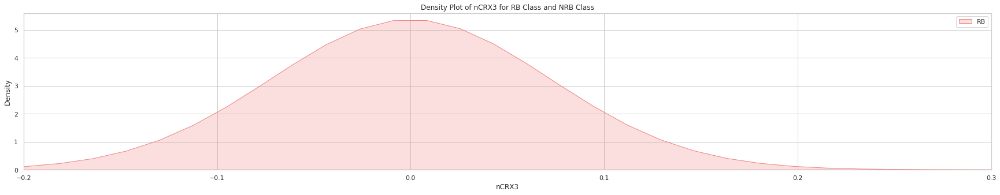

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nCRX3', -0.2, 0.3)
OutLiersBox(df, 'nCRX3')

SpPosA_B(p): Normalized spectral positive sum from Burden matrix weighted by polarizability

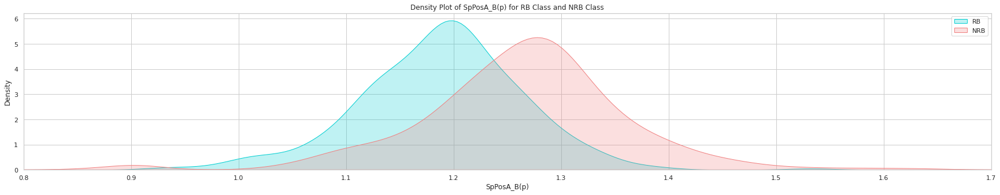

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'SpPosA_B(p)', 0.8, 1.7)
OutLiersBox(df, 'SpPosA_B(p)')

nCIR: Number of circuits

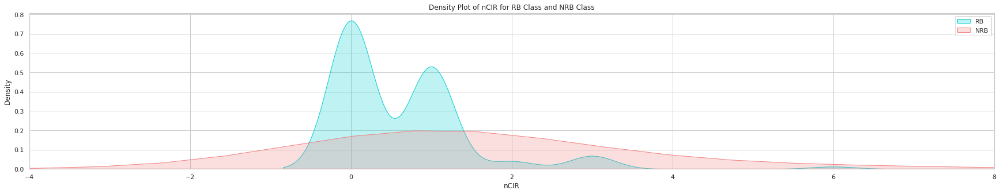

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nCIR', -4, 8)
OutLiersBox(df, 'nCIR')

B01[C-Br]: Presence/absence of C - Br at topological distance 1

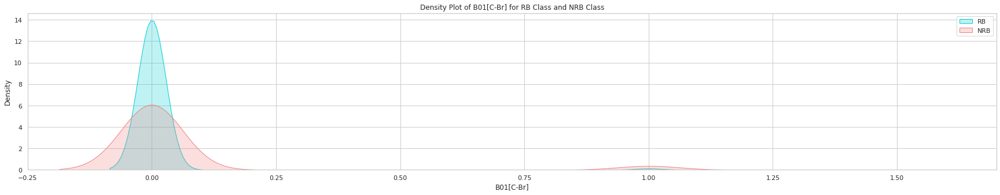

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'B01[C-Br]', -0.25, 1.7)
OutLiersBox(df, 'B01[C-Br]')

B03[C-Cl]: Presence/absence of C - Cl at topological distance 3

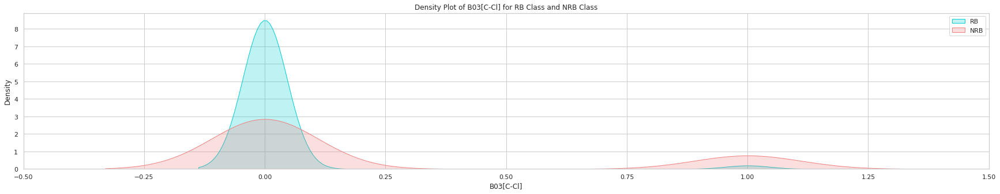

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'B03[C-Cl]', -0.5, 1.5)
OutLiersBox(df, 'B03[C-Cl]')

N-073: Ar2NH / Ar3N / Ar2N-Al / R..N..R

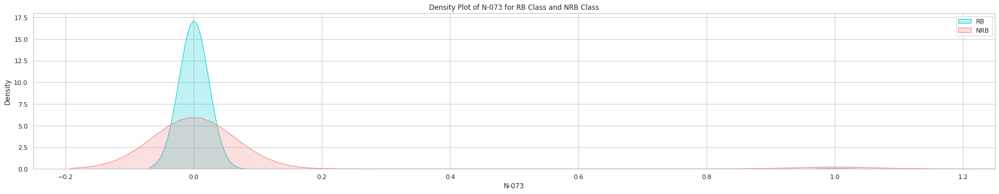

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'N-073', -0.25, 1.25)
OutLiersBox(df, 'N-073')

SpMax_A: Leading eigenvalue from adjacency matrix (Lovasz-Pelikan index)

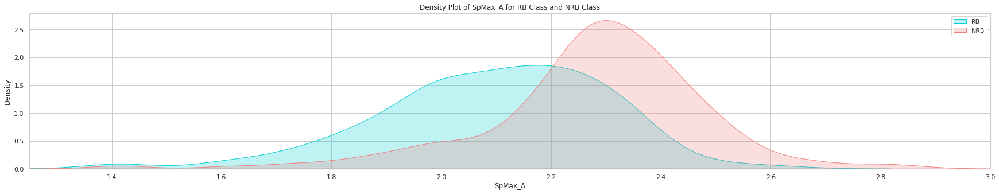

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'SpMax_A', 1.25, 3)
OutLiersBox(df, 'SpMax_A')

Psi_i_1d: Intrinsic state pseudoconnectivity index - type 1d

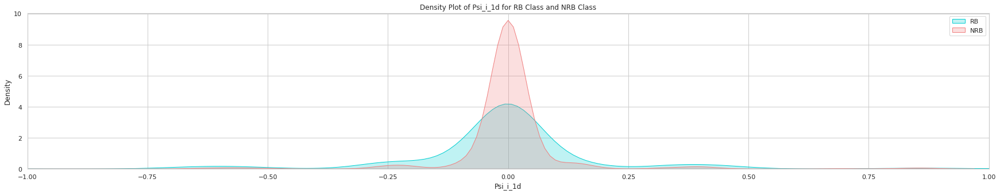

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'Psi_i_1d', -1, 1)
OutLiersBox(df, 'Psi_i_1d')

B04[C-Br]: Presence/absence of C - Br at topological distance 4

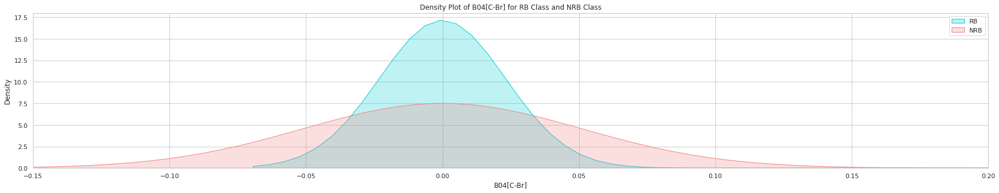

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'B04[C-Br]', -0.15, 0.2)
OutLiersBox(df, 'B04[C-Br]')

SdO: Sum of dO E-states

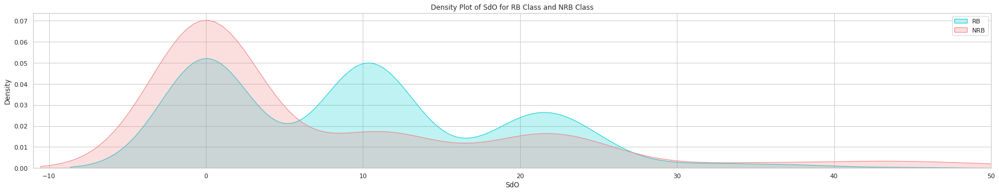

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'SdO', -11, 50)
OutLiersBox(df, 'SdO')

TI2_L: Second Mohar index from Laplace matrix

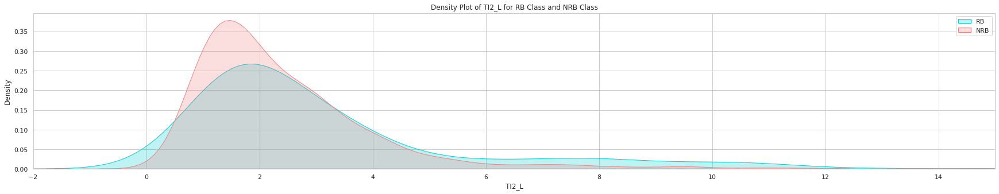

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'TI2_L', -2, 15)
OutLiersBox(df, 'TI2_L')

nCrt: Number of ring tertiary C(sp3)

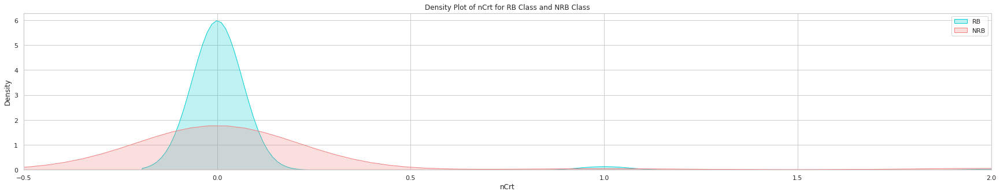

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nCrt', -0.5, 2)
OutLiersBox(df, 'nCrt')

C-026: R--CX--R

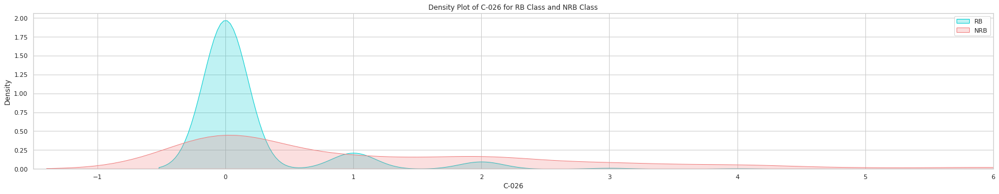

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'C-026', -1.5, 6)
OutLiersBox(df, 'C-026')

F02[C-N]: Frequency of C - N at topological distance 2

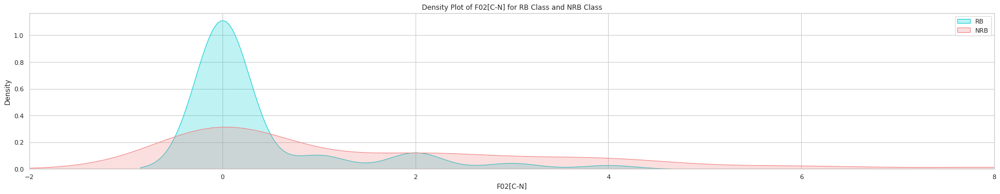

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'F02[C-N]', -2, 8)
OutLiersBox(df, 'F02[C-N]')

nHDon: Number of donor atoms for H-bonds (N and O)

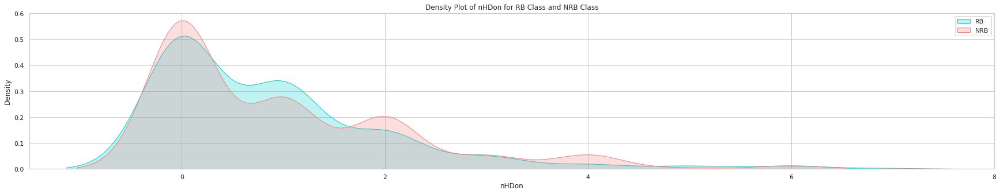

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nHDon', -1.5, 8)
OutLiersBox(df, 'nHDon')

SpMax_B(m): Leading eigenvalue from Burden matrix weighted by mass

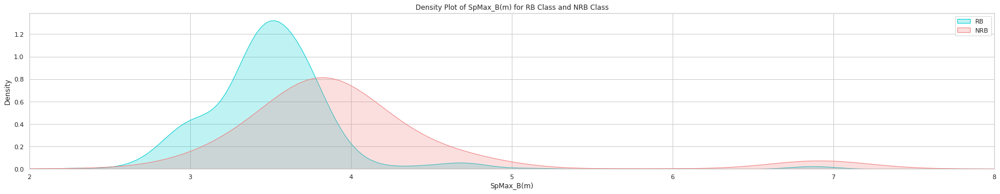

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'SpMax_B(m)', 2, 8)
OutLiersBox(df, 'SpMax_B(m)')

Psi_i_A: Intrinsic state pseudoconnectivity index - type S average

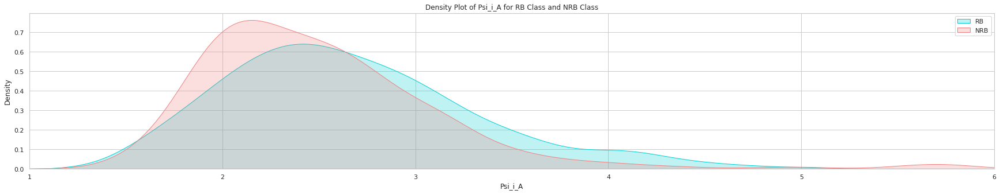

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'Psi_i_A', 1, 6)
OutLiersBox(df, 'Psi_i_A')

nN: Number of Nitrogen atoms

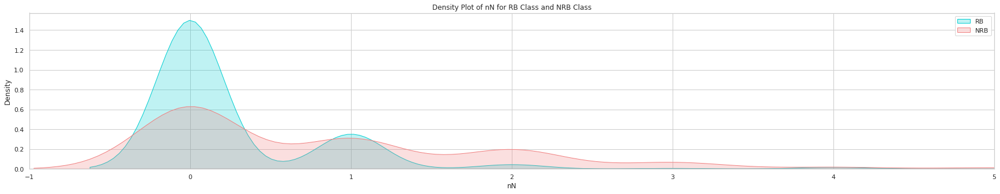

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nN', -1, 5)
OutLiersBox(df, 'nN')

SM6_B(m): Spectral moment of order 6 from Burden matrix weighted by mass

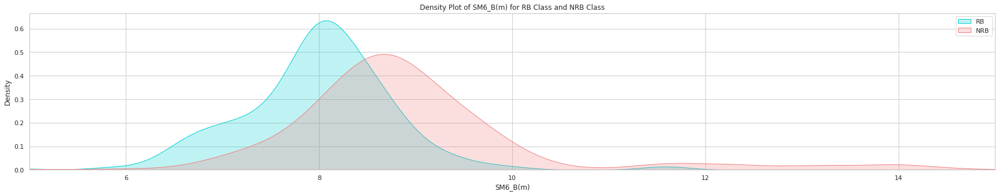

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'SM6_B(m)', 5, 15)
OutLiersBox(df, 'SM6_B(m)')

nArCOOR: Number of esters (aromatic)

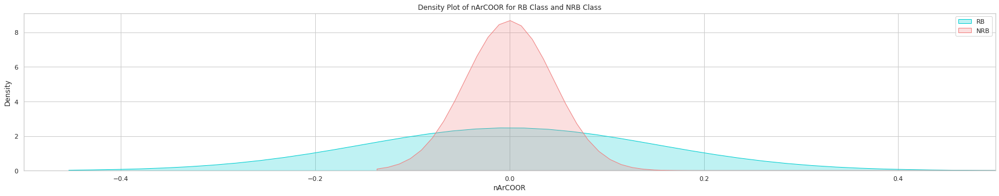

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nArCOOR', -0.5, 0.5)
OutLiersBox(df, 'nArCOOR')

nX: Number of halogen atoms

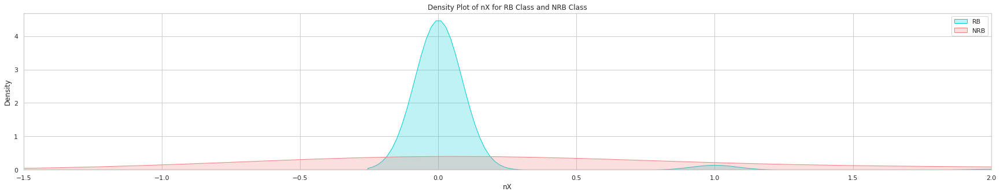

In [ ]:
configure_plotly_browser_state()
plotBarCat(df, 'nX', -1.5, 2)
OutLiersBox(df, 'nX')

### Evaluate Algorithms

In [ ]:
from pandas import set_option
from pandas.plotting import scatter_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier

In [ ]:
X = df.drop('experimental_class',  axis=1)
y = df['experimental_class']
X_train, X_test, y_train, y_test =train_test_split(X, y, test_size=0.25, random_state=0, stratify=df['experimental_class'])


Spot-Check Algorithms

In [ ]:
def GetBasedModel():
  basedModels = []
  basedModels.append(('LR'   , LogisticRegression()))
  basedModels.append(('LDA'  , LinearDiscriminantAnalysis()))
  basedModels.append(('KNN'  , KNeighborsClassifier()))
  basedModels.append(('CART' , DecisionTreeClassifier()))
  basedModels.append(('NB'   , GaussianNB()))
  basedModels.append(('SVM'  , SVC(probability=True)))
  basedModels.append(('AB'   , AdaBoostClassifier()))
  basedModels.append(('GBM'  , GradientBoostingClassifier()))
  basedModels.append(('RF'   , RandomForestClassifier()))
  basedModels.append(('ET'   , ExtraTreesClassifier()))
  
  return basedModels

In [ ]:
def BasedLine2(X_train, y_train, models):
  num_folds = 10
  scoring = 'accuracy'
  results = []
  names = []

  for name, model in models:
    kfold = StratifiedKFold(n_splits=num_folds, random_state=SEED)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    message = '%s: %f (%f)' % (name, cv_results.mean(), cv_results.std())
    print(message)

  return names, results

In [ ]:
class BoxPlotR:

  
  def __Trace(self, nameOfFeature, value):
    trace = go.Box(
        y=value,
        name = nameOfFeature,
        marker = dict(color = 'rgb(0, 128, 128)')
    )

    return trace


  def PlotResult(self):
    data =[]

    for i in range (len(self.names)):
      data.append(self.__Trace(self.names[i], self.results[i]))

    layout = go.Layout(template = 'plotly_white')
    fig = go.Figure(data=data, layout=layout)
    iplot(fig)


  def __init__(self, names, results):
    self.names = names
    self.results = results

In [ ]:
models = GetBasedModel()
names, results = BasedLine2(X_train, y_train, models)

configure_plotly_browser_state()
box_plot = BoxPlotR(names, results)
box_plot.PlotResult()

LR: 0.868608 (0.035397)
LDA: 0.845759 (0.033890)
KNN: 0.817943 (0.041322)
CART: 0.801582 (0.038811)
NB: 0.706725 (0.030105)
SVM: 0.810380 (0.034349)
AB: 0.861013 (0.032032)
GBM: 0.859668 (0.024980)
RF: 0.883718 (0.028620)
ET: 0.886266 (0.030253)


In [ ]:
def ScoreDataFrame(names, results):
  def floatingDecimals(f_val, dec=3):
    prc = '{:.' + str(dec) + 'f}'
    return float(prc.format(f_val))

  scores = []
  for result in results:
    scores.append(floatingDecimals(result.mean(), 4))
    
  scoreDataFrame = pd.DataFrame({'Model': names, 'Score': scores})

  return scoreDataFrame

In [ ]:
basedLineScore = ScoreDataFrame(names, results)
basedLineScore

,Model,Score
0,LR,0.8686
1,LDA,0.8458
2,KNN,0.8179
3,CART,0.8004
4,NB,0.7067
5,SVM,0.8104
6,AB,0.8610
7,GBM,0.8609
8,RF,0.8786
9,ET,0.8787


### Feature Engineering

Data preprocessing with pipeline

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

def GetScaledModel(nameOfScaler):
  scaler = StandardScaler() if (nameOfScaler == 'standard') else MinMaxScaler()

  pipelines = []
  pipelines.append((nameOfScaler + 'LR'  , Pipeline([('Scaler', scaler), ('LR'  , LogisticRegression())])))
  pipelines.append((nameOfScaler + 'LDA' , Pipeline([('Scaler', scaler), ('LDA' , LinearDiscriminantAnalysis())])))
  pipelines.append((nameOfScaler + 'KNN' , Pipeline([('Scaler', scaler), ('KNN' , KNeighborsClassifier())])))
  pipelines.append((nameOfScaler + 'CART', Pipeline([('Scaler', scaler), ('CART', DecisionTreeClassifier())])))
  pipelines.append((nameOfScaler + 'NB'  , Pipeline([('Scaler', scaler), ('NB'  , GaussianNB())])))
  pipelines.append((nameOfScaler + 'SVM' , Pipeline([('Scaler', scaler), ('SVM' , SVC())])))
  pipelines.append((nameOfScaler + 'AB'  , Pipeline([('Scaler', scaler), ('AB'  , AdaBoostClassifier())])))
  pipelines.append((nameOfScaler + 'GBM' , Pipeline([('Scaler', scaler), ('GBM' , GradientBoostingClassifier())])))
  pipelines.append((nameOfScaler + 'RF'  , Pipeline([('Scaler', scaler), ('RF'  , RandomForestClassifier())])))
  pipelines.append((nameOfScaler + 'ET'  , Pipeline([('Scaler', scaler), ('ET'  , ExtraTreesClassifier())])))

  return pipelines

Data Preprocessing with Standard Scaler

In [ ]:
models = GetScaledModel('standard')
names, results = BasedLine2(X_train, y_train, models)

configure_plotly_browser_state()
box_plot = BoxPlotR(names, results)
box_plot.PlotResult()

standardLR: 0.871123 (0.037939)
standardLDA: 0.845759 (0.033890)
standardKNN: 0.857184 (0.031310)
standardCART: 0.810396 (0.022356)
standardNB: 0.682642 (0.034476)
standardSVM: 0.876155 (0.036814)
standardAB: 0.861013 (0.032032)
standardGBM: 0.860934 (0.024023)
standardRF: 0.879921 (0.023376)
standardET: 0.882500 (0.026697)


Comparison with the previous model

In [ ]:
scaledScoreStandard = ScoreDataFrame(names, results)
compareModels = pd.concat([basedLineScore, scaledScoreStandard], axis=1)
compareModels

,Model,Score,Model,Score
0,LR,0.8686,standardLR,0.8711
1,LDA,0.8458,standardLDA,0.8458
2,KNN,0.8179,standardKNN,0.8572
3,CART,0.8004,standardCART,0.8066
4,NB,0.7067,standardNB,0.6826
5,SVM,0.8104,standardSVM,0.8762
6,AB,0.8610,standardAB,0.8610
7,GBM,0.8609,standardGBM,0.8609
8,RF,0.8786,standardRF,0.8812
9,ET,0.8787,standardET,0.8812


Data Preprocessing with MinMax Scaler

In [ ]:
models = GetScaledModel('minmax')
names, results = BasedLine2(X_train, y_train, models)

configure_plotly_browser_state()
box_plot = BoxPlotR(names, results)
box_plot.PlotResult()

minmaxLR: 0.841994 (0.039221)
minmaxLDA: 0.845759 (0.033890)
minmaxKNN: 0.853370 (0.030998)
minmaxCART: 0.806646 (0.039587)
minmaxNB: 0.692769 (0.026829)
minmaxSVM: 0.860965 (0.036986)
minmaxAB: 0.861013 (0.032032)
minmaxGBM: 0.859668 (0.023663)
minmaxRF: 0.882484 (0.031243)
minmaxET: 0.878687 (0.026346)


Comparisons with previous models

In [ ]:
scaledScoreMinMax = ScoreDataFrame(names, results)
compareModels = pd.concat([basedLineScore, scaledScoreStandard, scaledScoreMinMax], axis=1)
compareModels

,Model,Score,Model,Score,Model,Score
0,LR,0.8686,standardLR,0.8711,minmaxLR,0.8420
1,LDA,0.8458,standardLDA,0.8458,minmaxLDA,0.8458
2,KNN,0.8179,standardKNN,0.8572,minmaxKNN,0.8534
3,CART,0.8016,standardCART,0.8104,minmaxCART,0.8066
4,NB,0.7067,standardNB,0.6826,minmaxNB,0.6928
5,SVM,0.8104,standardSVM,0.8762,minmaxSVM,0.8610
6,AB,0.8610,standardAB,0.8610,minmaxAB,0.8610
7,GBM,0.8597,standardGBM,0.8609,minmaxGBM,0.8597
8,RF,0.8837,standardRF,0.8799,minmaxRF,0.8825
9,ET,0.8863,standardET,0.8825,minmaxET,0.8787


Eveluate the effect of outliers on model

In [ ]:
df_clean = df.drop('experimental_class', axis=1)

In [ ]:
def RemoveOutliers(df_out, nameOfFeature, drop=False):
  valueOfFeature = df_out[nameOfFeature]
  Q1 = np.percentile(valueOfFeature, 25.)
  Q3 = np.percentile(valueOfFeature, 75.)

  step = (Q3 - Q1) * 1.5
  outliers = valueOfFeature[~((valueOfFeature >= Q1 - step) & (valueOfFeature <= Q3 + step))].index.tolist()
  feature_outliers = valueOfFeature[~((valueOfFeature >= Q1 - step) & (valueOfFeature <= Q3 + step))].values

  print ("Number of outliers (inc duplicates): {} and outliers: {}".format(len(outliers), feature_outliers))
  if drop:
      good_data = df_out.drop(df_out.index[outliers]).reset_index(drop = True)
      print ("New dataset with removed outliers has {} samples with {} features each.".format(*good_data.shape))
      return good_data
  else: 
      print ("Nothing happens, df.shape = ",df_out.shape)
      return df_out

In [ ]:
for column in df_clean.columns:
  feature = column
  df_clean = RemoveOutliers(df_clean, feature, True)
  configure_plotly_browser_state()
  OutLiersBox(df_clean, feature)

Number of outliers (inc duplicates): 32 and outliers: [3.    2.    3.414 3.414 3.414 3.    3.    3.414 3.414 3.    3.414 3.414
 3.    6.316 6.33  3.    3.414 3.414 3.    3.414 3.414 2.    3.    3.
 6.177 3.    3.    6.496 6.294 6.272 6.242 6.253]
New dataset with removed outliers has 1023 samples with 41 features each.


Number of outliers (inc duplicates): 24 and outliers: [5.0476 5.6969 0.8039 4.8614 4.9627 4.8079 6.9923 5.431  4.8224 4.9583
 5.159  5.1487 5.4486 5.2014 5.7899 5.554  5.581  5.7766 5.2824 5.6107
 4.9033 5.0351 1.1387 5.8726]
New dataset with removed outliers has 999 samples with 41 features each.


Number of outliers (inc duplicates): 86 and outliers: [ 3  3  6  5  6  6  8  8  3  4  4  5  3  4  4  3  3  4  6  4  5  6  4  6
  5  5  6  4  3  3  3  3  3  4 10  4  6  4  5  6  4  4  3  3  3  3  4  6
  3  3  5  5  8 12 10  4  5  3  4  4  4  3  4  3  4  5  3  6  4  4 10  6
  5  7  6  3  3  3  3  4  3  3  4  4  3  5]
New dataset with removed outliers has 913 samples with 41 features each.


Number of outliers (inc duplicates): 27 and outliers: [2 1 1 1 1 1 1 2 1 1 1 1 2 1 2 2 3 2 1 1 1 1 2 2 1 2 1]
New dataset with removed outliers has 886 samples with 41 features each.


Number of outliers (inc duplicates): 92 and outliers: [ 6  4  6  7  4  8  4  6  6  4  3  3  4  3  3 10  4  4  4  3  6  6  3  3
  3  4  3  6  5  6  3  3  3  4  6  3  4  7  7  6  4  6 12  4  3  4  3  5
  3  3  5 10  8  3  3  4  7  6  4  6  3  3  4  3  3  9  3  3  6  4  3  5
  3  3 11  3  5  6  6  4  3  6  7  4  4  9  6  8  4  6  9 36]
New dataset with removed outliers has 794 samples with 41 features each.


Number of outliers (inc duplicates): 88 and outliers: [1 1 2 1 2 1 3 4 3 4 2 1 1 1 1 1 2 2 2 1 2 2 1 2 1 2 1 1 1 2 1 3 1 1 9 6 2
 1 2 1 1 1 1 2 2 2 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 2 1 1 1 1 2 1
 1 1 1 1 4 2 1 2 1 1 1 1 1 2]
New dataset with removed outliers has 706 samples with 41 features each.


Number of outliers (inc duplicates): 12 and outliers: [6 6 8 6 7 6 6 6 6 9 6 6]
New dataset with removed outliers has 694 samples with 41 features each.


Number of outliers (inc duplicates): 1 and outliers: [10.]
New dataset with removed outliers has 693 samples with 41 features each.


Number of outliers (inc duplicates): 1 and outliers: [8]
New dataset with removed outliers has 692 samples with 41 features each.


Number of outliers (inc duplicates): 2 and outliers: [11  8]
New dataset with removed outliers has 690 samples with 41 features each.


Number of outliers (inc duplicates): 8 and outliers: [ 8  6  6  9  6 11 27  6]
New dataset with removed outliers has 682 samples with 41 features each.


Number of outliers (inc duplicates): 142 and outliers: [-1.29   2.487 -0.671 -0.653 -0.796 -0.759 -1.073 -1.21  -0.947 -2.498
 -1.426 -1.072 -0.919 -0.863 -1.1   -0.98  -0.952 -2.685 -0.986  3.12
  0.417 -0.664 -0.959 -2.138 -0.671 -0.913 -0.855 -1.068 -1.48  -1.396
 -1.072 -1.853 -2.514 -1.19   0.56  -0.738  2.495 -1.035 -3.296 -1.016
 -1.025 -1.165 -0.858 -0.87  -1.101 -1.417 -1.775 -0.879 -0.931 -1.113
 -1.648 -0.746  0.464 -0.884 -0.995  1.188 -0.833 -1.68  -2.514 -1.185
 -2.845 -0.644 -1.569  1.559 -0.892 -2.254  4.722 -2.476 -0.968 -0.657
 -1.641 -0.654 -0.981 -0.942 -0.888 -1.093 -1.291 -1.157 -0.686  0.498
  1.121  0.933  1.014  1.669 -1.05   1.18  -1.992  0.682 -0.89  -3.157
  0.787 -0.79  -2.406 -0.638 -2.409 -3.785 -0.991 -3.756  1.982 -0.688
  0.848 -1.375 -0.779 -0.741  0.532 -0.995 -0.862 -1.168 -0.896  1.008
 -0.929 -0.794 -0.608 -0.945 -0.678 -0.875 -0.872 -1.14  -1.74  -0.914
 -2.748 -1.424 -0.907 -1.5   -0.836 -0.664 -2.153 -3.537 -2.126  2.904
 -0.98  -0.888 -0.809  

Number of outliers (inc duplicates): 10 and outliers: [4.587 4.486 4.808 4.632 4.75  4.471 4.594 4.494 4.785 4.697]
New dataset with removed outliers has 530 samples with 41 features each.


Number of outliers (inc duplicates): 30 and outliers: [3.146 3.427 3.309 3.322 3.301 4.044 3.418 3.866 3.146 3.792 3.974 3.181
 3.774 3.355 3.524 3.554 3.882 3.866 3.706 3.113 3.44  3.301 4.12  3.459
 3.128 3.322 3.146 3.554 3.337 3.554]
New dataset with removed outliers has 500 samples with 41 features each.


Number of outliers (inc duplicates): 0 and outliers: []
New dataset with removed outliers has 500 samples with 41 features each.


Number of outliers (inc duplicates): 11 and outliers: [15 12 12 12 15 12 11 11 11 12 12]
New dataset with removed outliers has 489 samples with 41 features each.


Number of outliers (inc duplicates): 10 and outliers: [1.075 1.078 1.087 1.108 1.084 1.084 1.1   1.084 1.084 1.101]
New dataset with removed outliers has 479 samples with 41 features each.


Number of outliers (inc duplicates): 1 and outliers: [1.199]
New dataset with removed outliers has 478 samples with 41 features each.


Number of outliers (inc duplicates): 0 and outliers: []
New dataset with removed outliers has 478 samples with 41 features each.


Number of outliers (inc duplicates): 27 and outliers: [1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
New dataset with removed outliers has 451 samples with 41 features each.


Number of outliers (inc duplicates): 0 and outliers: []
New dataset with removed outliers has 451 samples with 41 features each.


Number of outliers (inc duplicates): 3 and outliers: [0.995 1.495 1.482]
New dataset with removed outliers has 448 samples with 41 features each.


Number of outliers (inc duplicates): 49 and outliers: [3 3 3 3 3 6 3 3 3 3 3 3 3 6 3 6 6 6 3 3 7 3 3 3 4 3 6 3 6 3 3 3 3 3 3 6 3
 3 6 3 6 3 7 3 3 3 3 6 6]
New dataset with removed outliers has 399 samples with 41 features each.


Number of outliers (inc duplicates): 13 and outliers: [1 1 1 1 1 1 1 1 1 1 1 1 1]
New dataset with removed outliers has 386 samples with 41 features each.


Number of outliers (inc duplicates): 51 and outliers: [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
New dataset with removed outliers has 335 samples with 41 features each.


Number of outliers (inc duplicates): 4 and outliers: [1 1 1 1]
New dataset with removed outliers has 331 samples with 41 features each.


Number of outliers (inc duplicates): 0 and outliers: []
New dataset with removed outliers has 331 samples with 41 features each.


Number of outliers (inc duplicates): 62 and outliers: [-0.204  0.294 -0.181 -0.181 -0.195 -0.522 -0.205  0.34   0.391 -0.229
 -0.236 -0.218 -0.596  0.425 -0.249 -0.263  0.149  0.149  0.342  0.322
  0.33  -0.552 -0.229  0.135  0.363  0.144 -0.228 -0.212  0.425 -0.239
  0.137 -0.223 -0.247 -0.65   0.141  0.15   0.368 -0.214  0.139 -0.213
  0.136  0.135 -0.197 -0.222  0.397 -0.557 -0.237  0.363 -0.197  0.323
  0.402  0.142 -0.237  0.343  0.375  0.137 -0.251 -0.226  0.143  0.139
  0.136 -0.264]
New dataset with removed outliers has 269 samples with 41 features each.


Number of outliers (inc duplicates): 0 and outliers: []
New dataset with removed outliers has 269 samples with 41 features each.


Number of outliers (inc duplicates): 0 and outliers: []
New dataset with removed outliers has 269 samples with 41 features each.


Number of outliers (inc duplicates): 11 and outliers: [5.588 6.131 6.086 5.698 6.651 8.486 6.102 6.687 5.623 5.864 6.393]
New dataset with removed outliers has 258 samples with 41 features each.


Number of outliers (inc duplicates): 7 and outliers: [1 1 1 1 2 1 2]
New dataset with removed outliers has 251 samples with 41 features each.


Number of outliers (inc duplicates): 1 and outliers: [4]
New dataset with removed outliers has 250 samples with 41 features each.


Number of outliers (inc duplicates): 0 and outliers: []
New dataset with removed outliers has 250 samples with 41 features each.


Number of outliers (inc duplicates): 16 and outliers: [6 5 6 4 4 4 5 4 3 4 3 5 3 3 4 3]
New dataset with removed outliers has 234 samples with 41 features each.


Number of outliers (inc duplicates): 19 and outliers: [ 2.949  2.924  4.735  4.681  2.936  4.692  4.734  4.415  4.421  4.432
  4.725  4.433  4.702  4.66   2.881  4.735  4.412 10.355  4.725]
New dataset with removed outliers has 215 samples with 41 features each.


Number of outliers (inc duplicates): 1 and outliers: [3.417]
New dataset with removed outliers has 214 samples with 41 features each.


Number of outliers (inc duplicates): 1 and outliers: [3]
New dataset with removed outliers has 213 samples with 41 features each.


Number of outliers (inc duplicates): 12 and outliers: [7.074 7.119 7.119 7.083 6.823 6.76  7.081 7.135 7.138 6.883 7.078 6.951]
New dataset with removed outliers has 201 samples with 41 features each.


Number of outliers (inc duplicates): 3 and outliers: [1 1 1]
New dataset with removed outliers has 198 samples with 41 features each.


Number of outliers (inc duplicates): 2 and outliers: [2 1]
New dataset with removed outliers has 196 samples with 41 features each.


*   Since the data is left with only 196 samples, it might be bad idea to remove all of the outliers from all of the data.

### Feature Selection

KNN and NB is removed because it does not provide logic to do feature selection.

In [ ]:
def GetModel():
  basedModels = []
  basedModels.append(('LR'   , LogisticRegression()))
  basedModels.append(('LDA'  , LinearDiscriminantAnalysis()))
  basedModels.append(('CART' , DecisionTreeClassifier()))
  basedModels.append(('SVM'  , SVC(kernel='linear')))
  basedModels.append(('AB'   , AdaBoostClassifier()))
  basedModels.append(('GBM'  , GradientBoostingClassifier()))
  basedModels.append(('RF'   , RandomForestClassifier()))
  basedModels.append(('ET'   , ExtraTreesClassifier()))
  
  return basedModels

Recursive feature elimination

In [ ]:
from sklearn.feature_selection import RFECV

In [ ]:
def FeatureSelectionRFECV(models):
  for name, model in models:
    selector = RFECV(model, step=1, cv=5)
    rfecv = selector.fit(X, y)

    print("Optimal number of features: %d" % rfecv.n_features_)
    print('Selected features: %s' % list(X.columns[rfecv.support_]))

    plt.figure(figsize=(10, 6))
    plt.xlabel("Number of features selected")
    plt.ylabel("Cross validation score (no. of correct classifications)")
    plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_)
    plt.title(name + ' RFECV feature selection')
    plt.show()

Optimal number of features: 12
Selected features: ['SpMax_L', 'J_Dz(e)', 'nHM', 'NssssC', 'nCb-', 'SM6_L', 'nN-N', 'nArNO2', 'nCrt', 'Psi_i_A', 'nN', 'nArCOOR']


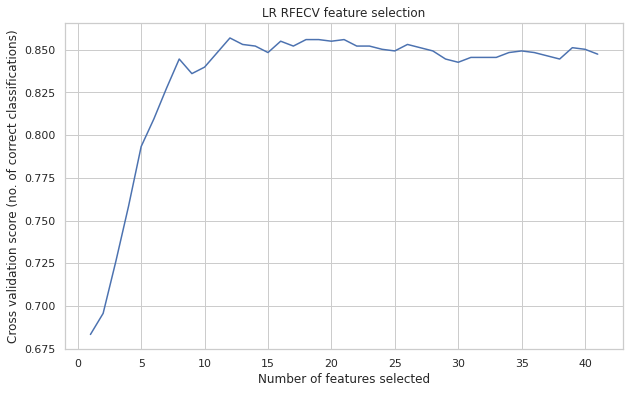

Optimal number of features: 24
Selected features: ['SpMax_L', 'J_Dz(e)', 'F01[N-N]', 'nO', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'Me', 'Mi', 'nN-N', 'nArNO2', 'SpPosA_B(p)', 'B01[C-Br]', 'B03[C-Cl]', 'N-073', 'Psi_i_1d', 'B04[C-Br]', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']


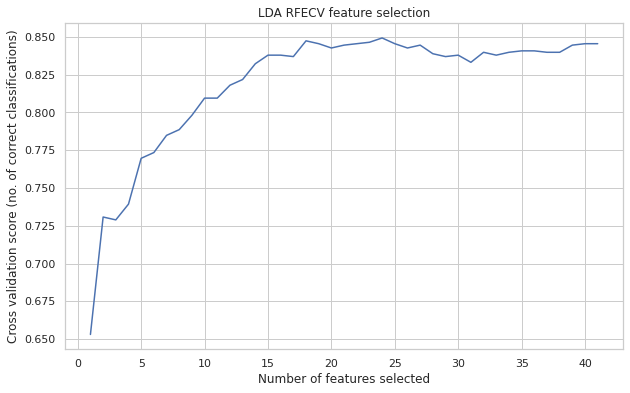

Optimal number of features: 35
Selected features: ['SpMax_L', 'J_Dz(e)', 'nHM', 'F01[N-N]', 'F04[C-N]', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'F03[C-N]', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'SpPosA_B(p)', 'nCIR', 'B01[C-Br]', 'B03[C-Cl]', 'N-073', 'SpMax_A', 'Psi_i_1d', 'SdO', 'TI2_L', 'nCrt', 'C-026', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'SM6_B(m)', 'nArCOOR']


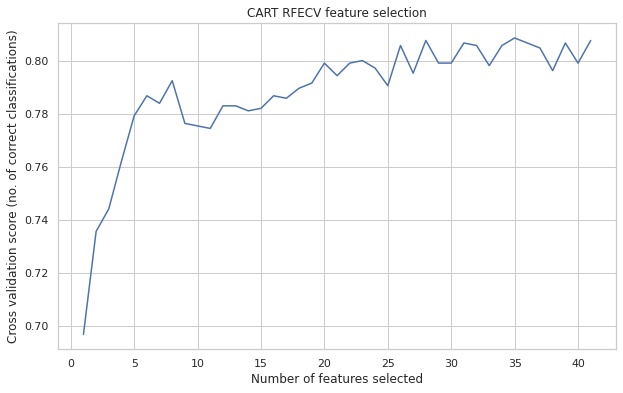

Optimal number of features: 14
Selected features: ['SpMax_L', 'nHM', 'NssssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'nN-N', 'nArNO2', 'B01[C-Br]', 'N-073', 'nCrt', 'Psi_i_A', 'nN', 'nArCOOR']


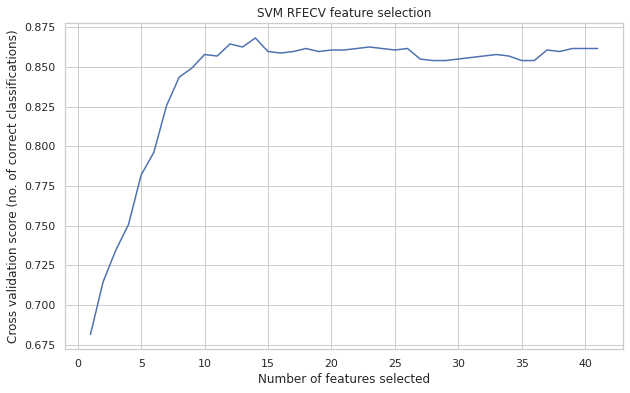

Optimal number of features: 28
Selected features: ['SpMax_L', 'J_Dz(e)', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'SdssC', 'HyWi_B(m)', 'LOC', 'F03[C-O]', 'Me', 'Mi', 'nArNO2', 'SpPosA_B(p)', 'SpMax_A', 'Psi_i_1d', 'TI2_L', 'nCrt', 'C-026', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']


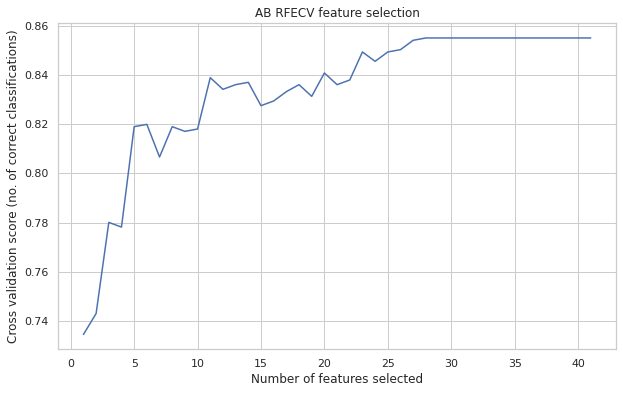

Optimal number of features: 32
Selected features: ['SpMax_L', 'J_Dz(e)', 'nHM', 'F04[C-N]', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'F03[C-N]', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'SpPosA_B(p)', 'nCIR', 'SpMax_A', 'Psi_i_1d', 'SdO', 'TI2_L', 'nCrt', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']


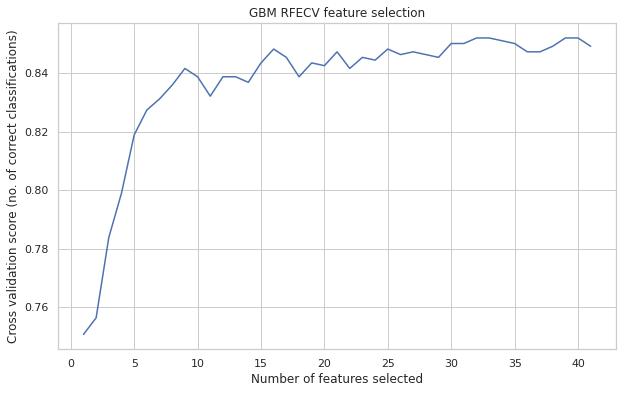

Optimal number of features: 30
Selected features: ['SpMax_L', 'J_Dz(e)', 'nHM', 'F04[C-N]', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'F03[C-N]', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'SpPosA_B(p)', 'SpMax_A', 'Psi_i_1d', 'SdO', 'TI2_L', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']


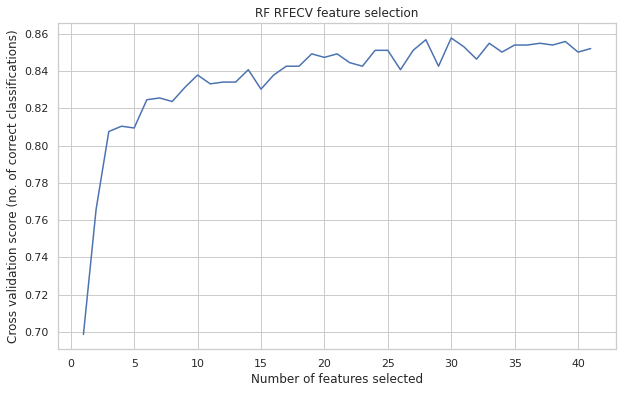

Optimal number of features: 38
Selected features: ['SpMax_L', 'J_Dz(e)', 'nHM', 'F01[N-N]', 'F04[C-N]', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'F03[C-N]', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'nN-N', 'nArNO2', 'SpPosA_B(p)', 'nCIR', 'B01[C-Br]', 'B03[C-Cl]', 'SpMax_A', 'Psi_i_1d', 'SdO', 'TI2_L', 'nCrt', 'C-026', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']


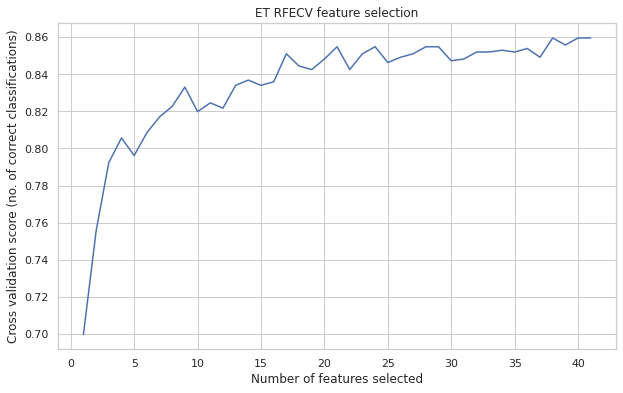

In [ ]:
models = GetModel()
FeatureSelectionRFECV(models)

It seems that different model have different optimal number of features when RFE CV is used.

SelectFromModel

In [ ]:
from sklearn.feature_selection import SelectFromModel

In [ ]:
def FeatureSelectionSFM(models):
  for name, model in models:
    feature_names = X.columns
    sfm_selector = SelectFromModel(estimator=model)
    clf = sfm_selector.fit(X, y)
    name_features = sfm_selector.get_support()
    print(f'Selected features for {name}: {X.columns[name_features]}')

In [ ]:
models = GetModel()
FeatureSelectionSFM(models)

Selected features for LR: Index(['SpMax_L', 'J_Dz(e)', 'nHM', 'NssssC', 'nCb-', 'HyWi_B(m)', 'LOC',
       'nN-N', 'nArNO2', 'nCrt', 'F02[C-N]', 'Psi_i_A', 'nN', 'nArCOOR', 'nX'],
      dtype='object')
Selected features for LDA: Index(['SpMax_L', 'SM6_L', 'Me', 'Mi', 'nN-N', 'SpPosA_B(p)', 'B01[C-Br]',
       'Psi_i_A', 'SM6_B(m)'],
      dtype='object')
Selected features for CART: Index(['SpMax_L', 'J_Dz(e)', 'nO', 'SdssC', 'HyWi_B(m)', 'Mi', 'SdO',
       'F02[C-N]', 'SpMax_B(m)', 'SM6_B(m)', 'nArCOOR'],
      dtype='object')
Selected features for SVM: Index(['SpMax_L', 'nHM', 'NssssC', 'nCb-', 'HyWi_B(m)', 'LOC', 'SM6_L', 'nN-N',
       'nArNO2', 'N-073', 'nCrt', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)',
       'nArCOOR'],
      dtype='object')
Selected features for AB: Index(['SpMax_L', 'J_Dz(e)', 'C%', 'SdssC', 'Me', 'SpPosA_B(p)', 'SpMax_A',
       'TI2_L', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN'],
      dtype='object')
Selected features for GBM: Index(['SpMax_L', 'SdssC', 'F03[C

Once more, when the model is fitted using SelectFromModel, it shows a slightly different number of features compared to RFE CV. 

### Model training using feature selection from RFE CV

In [ ]:
def BasedLine3(df_train, y_train, models):
  num_folds = 10
  scoring = 'accuracy'
  results = []
  names = []

  for name, model in models:
    if name == 'LR':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'nHM', 'NssssC', 'nCb-', 'SM6_L', 'nN-N', 'nArNO2', 'nCrt', 'Psi_i_A', 'nN', 'nArCOOR']]
    elif name == 'LDA':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'F01[N-N]', 'nO', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'Me', 'Mi', 'nN-N', 'nArNO2', 'SpPosA_B(p)', 'B01[C-Br]', 'B03[C-Cl]', 'N-073', 'Psi_i_1d', 'B04[C-Br]', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']]
    elif name == 'CART':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'nHM', 'F04[C-N]', 'C%', 'nCp', 'nO', 'F03[C-N]', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'SpPosA_B(p)', 'SpMax_A', 'SdO', 'TI2_L', 'nCrt', 'C-026', 'F02[C-N]', 'SpMax_B(m)', 'Psi_i_A', 'SM6_B(m)', 'nArCOOR']]
    elif name == 'SVM':
      X_train = df_train[['SpMax_L', 'nHM', 'NssssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'nN-N', 'nArNO2', 'B01[C-Br]', 'N-073', 'nCrt', 'Psi_i_A', 'nN', 'nArCOOR']]
    elif name == 'AB':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'SdssC', 'HyWi_B(m)', 'LOC', 'F03[C-O]', 'Me', 'Mi', 'nArNO2', 'SpPosA_B(p)', 'SpMax_A', 'Psi_i_1d', 'TI2_L', 'nCrt', 'C-026', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']]
    elif name == 'GBM':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'nHM', 'F04[C-N]', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'F03[C-N]', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'SpPosA_B(p)', 'nCIR', 'SpMax_A', 'Psi_i_1d', 'SdO', 'TI2_L', 'nCrt', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']]
    elif name == 'RF':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'nHM', 'F04[C-N]', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'F03[C-N]', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'SpPosA_B(p)', 'nCIR', 'SpMax_A', 'Psi_i_1d', 'SdO', 'TI2_L', 'nCrt', 'C-026', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']]
    elif name == 'ET':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'nHM', 'F01[N-N]', 'F04[C-N]', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'F03[C-N]', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'nArNO2', 'SpPosA_B(p)', 'nCIR', 'B03[C-Cl]', 'SpMax_A', 'Psi_i_1d', 'SdO', 'TI2_L', 'nCrt', 'C-026', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX']]
    else:
      X_train = df_train
    
    kfold = StratifiedKFold(n_splits=num_folds, random_state=SEED)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    message = '%s: %f (%f)' % (name, cv_results.mean(), cv_results.std())
    print(message)

  return names, results

In [ ]:
models = GetScaledModel('standard')
names, results = BasedLine3(X_train, y_train, models)

standardLR: 0.871123 (0.037939)
standardLDA: 0.845759 (0.033890)
standardKNN: 0.857184 (0.031310)
standardCART: 0.823006 (0.034903)
standardNB: 0.682642 (0.034476)
standardSVM: 0.876155 (0.036814)
standardAB: 0.861013 (0.032032)
standardGBM: 0.860934 (0.020417)
standardRF: 0.883718 (0.033758)
standardET: 0.879921 (0.021963)


In [ ]:
scaledFSScoreStandard = ScoreDataFrame(names, results)
compareModels = pd.concat([basedLineScore, scaledScoreStandard, scaledScoreMinMax, scaledFSScoreStandard], axis=1)
compareModels

,Model,Score,Model,Score,Model,Score,Model,Score
0,LR,0.8686,standardLR,0.8711,minmaxLR,0.8420,standardLR,0.8711
1,LDA,0.8458,standardLDA,0.8458,minmaxLDA,0.8458,standardLDA,0.8458
2,KNN,0.8179,standardKNN,0.8572,minmaxKNN,0.8534,standardKNN,0.8572
3,CART,0.8016,standardCART,0.8104,minmaxCART,0.8066,standardCART,0.8230
4,NB,0.7067,standardNB,0.6826,minmaxNB,0.6928,standardNB,0.6826
5,SVM,0.8104,standardSVM,0.8762,minmaxSVM,0.8610,standardSVM,0.8762
6,AB,0.8610,standardAB,0.8610,minmaxAB,0.8610,standardAB,0.8610
7,GBM,0.8597,standardGBM,0.8609,minmaxGBM,0.8597,standardGBM,0.8609
8,RF,0.8837,standardRF,0.8799,minmaxRF,0.8825,standardRF,0.8837
9,ET,0.8863,standardET,0.8825,minmaxET,0.8787,standardET,0.8799


### Model training using feature selection from SelectFromModel

In [ ]:
def BasedLine4(df_train, y_train, models):
  num_folds = 10
  scoring = 'accuracy'
  results = []
  names = []

  for name, model in models:
    if name == 'LR':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'nHM', 'NssssC', 'nCb-', 'HyWi_B(m)', 'LOC', 'nN-N', 'nArNO2', 'nCrt', 'F02[C-N]', 'Psi_i_A', 'nN', 'nArCOOR', 'nX']]
    elif name == 'LDA':
      X_train = df_train[['SpMax_L', 'SM6_L', 'Me', 'Mi', 'nN-N', 'SpPosA_B(p)', 'B01[C-Br]', 'Psi_i_A', 'SM6_B(m)']]
    elif name == 'CART':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'nO', 'SdssC', 'HyWi_B(m)', 'Mi', 'SdO', 'F02[C-N]', 'SpMax_B(m)', 'SM6_B(m)', 'nArCOOR']]
    elif name == 'SVM':
      X_train = df_train[['SpMax_L', 'nHM', 'NssssC', 'nCb-', 'HyWi_B(m)', 'LOC', 'SM6_L', 'nN-N', 'nArNO2', 'N-073', 'nCrt', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR']]
    elif name == 'AB':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'C%', 'SdssC', 'Me', 'SpPosA_B(p)', 'SpMax_A', 'TI2_L', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN']]
    elif name == 'GBM':
      X_train = df_train[['SpMax_L', 'SdssC', 'F03[C-O]', 'SpPosA_B(p)', 'SpMax_A', 'SdO', 'F02[C-N]', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR']]
    elif name == 'RF':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'C%', 'nO', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'SpPosA_B(p)', 'SpMax_A', 'SdO', 'TI2_L', 'F02[C-N]', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)']]
    elif name == 'ET':
      X_train = df_train[['SpMax_L', 'J_Dz(e)', 'nHM', 'nCb-', 'C%', 'nCp', 'nO', 'F03[C-N]', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'SpPosA_B(p)', 'SpMax_A', 'SdO', 'TI2_L', 'F02[C-N]', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)']]
    else:
      X_train = df_train

    kfold = StratifiedKFold(n_splits=num_folds, random_state=SEED)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    message = '%s: %f (%f)' % (name, cv_results.mean(), cv_results.std())
    print(message)

  return names, results

In [ ]:
models = GetScaledModel('standard')
names, results = BasedLine4(X_train, y_train, models)

standardLR: 0.871123 (0.037939)
standardLDA: 0.845759 (0.033890)
standardKNN: 0.857184 (0.031310)
standardCART: 0.804114 (0.042796)
standardNB: 0.682642 (0.034476)
standardSVM: 0.876155 (0.036814)
standardAB: 0.861013 (0.032032)
standardGBM: 0.859668 (0.021536)
standardRF: 0.881203 (0.029317)
standardET: 0.881203 (0.030390)


In [ ]:
scaledSFBScoreStandard = ScoreDataFrame(names, results)
compareModels = pd.concat([basedLineScore, scaledScoreStandard, scaledScoreMinMax, scaledFSScoreStandard, scaledSFBScoreStandard], axis=1)
compareModels

,Model,Score,Model,Score,Model,Score,Model,Score,Model,Score
0,LR,0.8686,standardLR,0.8711,minmaxLR,0.8420,standardLR,0.8711,standardLR,0.8711
1,LDA,0.8458,standardLDA,0.8458,minmaxLDA,0.8458,standardLDA,0.8458,standardLDA,0.8458
2,KNN,0.8179,standardKNN,0.8572,minmaxKNN,0.8534,standardKNN,0.8572,standardKNN,0.8572
3,CART,0.8016,standardCART,0.8104,minmaxCART,0.8066,standardCART,0.8230,standardCART,0.8041
4,NB,0.7067,standardNB,0.6826,minmaxNB,0.6928,standardNB,0.6826,standardNB,0.6826
5,SVM,0.8104,standardSVM,0.8762,minmaxSVM,0.8610,standardSVM,0.8762,standardSVM,0.8762
6,AB,0.8610,standardAB,0.8610,minmaxAB,0.8610,standardAB,0.8610,standardAB,0.8610
7,GBM,0.8597,standardGBM,0.8609,minmaxGBM,0.8597,standardGBM,0.8609,standardGBM,0.8597
8,RF,0.8837,standardRF,0.8799,minmaxRF,0.8825,standardRF,0.8837,standardRF,0.8812
9,ET,0.8863,standardET,0.8825,minmaxET,0.8787,standardET,0.8799,standardET,0.8812




*   It seems like feature selection does not produce much impact onto the model.
*   Nevertheless, feature selection is performed to reduce the training time.



### Algorithm Tuning

In [ ]:
df_unscaled = df[['SpMax_L', 'J_Dz(e)', 'nHM', 'F01[N-N]', 'F04[C-N]', 'NssssC', 'nCb-', 'C%', 'nCp', 'nO', 'F03[C-N]', 'SdssC', 'HyWi_B(m)', 'LOC', 'SM6_L', 'F03[C-O]', 'Me', 'Mi', 'nArNO2', 'SpPosA_B(p)', 'nCIR', 'B03[C-Cl]', 'SpMax_A', 'Psi_i_1d', 'SdO', 'TI2_L', 'nCrt', 'C-026', 'F02[C-N]', 'nHDon', 'SpMax_B(m)', 'Psi_i_A', 'nN', 'SM6_B(m)', 'nArCOOR', 'nX', 'nN-N', 'B01[C-Br]', 'N-073', 'B04[C-Br]', 'experimental_class']]
df_imp_scaled_name = df_unscaled.columns


In [ ]:
X = df_unscaled.drop('experimental_class', axis=1)
y = df_unscaled['experimental_class']
X = StandardScaler().fit_transform(X)
X_train_sc, X_test_sc, y_train_sc, y_test_sc = train_test_split(X, y, test_size=0.25, random_state=0, stratify=y)

In [ ]:
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from scipy.stats import uniform
from scipy.stats import randint

In [ ]:
class RandomSearch(object):

  
  def __init__(self, X_train, y_train, model, hyperparameters):
    self.X_train = X_train
    self.y_train = y_train
    self.model = model
    self.hyperparameters = hyperparameters


  def RandomSearch(self):
    cv = 10
    clf = RandomizedSearchCV(self.model, self.hyperparameters, random_state=1, n_iter=100, cv=cv, verbose=0, n_jobs=1)
    best_model = clf.fit(self.X_train, self.y_train)
    message = (best_model.best_score_, best_model.best_params_)
    print('Best: %f using %s' % (message))

    return best_model, best_model.best_params_

  
  def BestModelPredict(self, X_test):
    best_model,_ = self.RandomSearch()
    prediction = best_model.predict(X_test)
    print('\n' + classification_report(y_test, prediction))
    
    return prediction

In [ ]:
class GridSearch(object):


  def __init__(self, X_train, y_train, model, hyperparameters):
    self.X_train = X_train
    self.y_train = y_train
    self.model = model
    self.hyperparameters = hyperparameters


  def GridSearch(self):
    cv = 10
    clf = GridSearchCV(self.model, self.hyperparameters, cv=cv, verbose=0, n_jobs=1)
    best_model = clf.fit(self.X_train, self.y_train)
    message = (best_model.best_score_, best_model.best_params_)
    print("Best: %f using %s" % (message))

    return best_model, best_model.best_params_


  def BestModelPredict(self, X_test):
    best_model,_ = self.GridSearch()
    prediction = best_model.predict(X_test)
    print('\n' + classification_report(y_test, prediction))
    
    return prediction

In [ ]:
def floatingDecimals(f_val, dec=3):
  prc = '{:.' + str(dec) + 'f}'
  return float(prc.format(f_val))

Logistic Regression: Best Parameter


*   C : Regularization value, the more, the stronger the regularization(double).
*   RegularizationType: Can be either "L2" or "L1". Default is "L2".
*   Multi_class: Can be either 'auto', 'ovr', 'multinomial'



In [ ]:
LR_model = LogisticRegression()
LR_penalty = ['l1', 'l2']
LR_C = uniform(loc = 0, scale=4)
LR_multi_class = ['auto', 'ovr', 'multinomial']
LR_param_grid = dict(C=LR_C, penalty=LR_penalty, multi_class=LR_multi_class)

LR_RandomSearch = RandomSearch(X_train_sc, y_train_sc, LR_model, LR_param_grid)
LR_Prediction = LR_RandomSearch.BestModelPredict(X_test_sc)
print('Prediction on test set is:' , floatingDecimals((y_test_sc == LR_Prediction).mean(), 7))

Best: 0.873655 using {'C': 0.4779618719228673, 'multi_class': 'ovr', 'penalty': 'l2'}

              precision    recall  f1-score   support

           0       0.89      0.94      0.91       175
           1       0.86      0.76      0.81        89

    accuracy                           0.88       264
   macro avg       0.87      0.85      0.86       264
weighted avg       0.88      0.88      0.88       264

Prediction on test set is: 0.8787879


KNN: Best Parameter
*   n_neighbors: Number of neighbors to use by default for k_neighbors queries
*   weights: Weight function used in prediction

In [ ]:
KNN_model = KNeighborsClassifier()
KNN_neighbors = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
KNN_weights = ['uniform', 'distance']
KNN_param_grid = dict(n_neighbors=KNN_neighbors, weights=KNN_weights)

KNN_GridSearch = GridSearch(X_train_sc, y_train_sc, KNN_model, KNN_param_grid)
KNN_Prediction = KNN_GridSearch.BestModelPredict(X_test_sc)
print('Prediction on test set is:' ,floatingDecimals((y_test_sc == KNN_Prediction).mean(), 7))

Best: 0.871076 using {'n_neighbors': 6, 'weights': 'distance'}

              precision    recall  f1-score   support

           0       0.90      0.90      0.90       175
           1       0.80      0.81      0.80        89

    accuracy                           0.87       264
   macro avg       0.85      0.85      0.85       264
weighted avg       0.87      0.87      0.87       264

Prediction on test set is: 0.8674242


SVM: Best Parameter
*   C: The Penalty parameter C of the error term. 
*   Kernel: Kernel type could be linear, poly, rbf or sigmoid.
*   Gamma: Kernel coefficient for RBF, Poly, or Sigmoid

In [ ]:
SVM_model = SVC()
SVM_c = [0.1, 0.3, 0.5, 0.7, 0.9, 1.0, 1.3, 1.5, 1.7, 2.0]
SVM_kernel = ['linear' , 'poly' , 'rbf' , 'sigmoid']
SVM_gamma = ['scale', 'auto']
SVM_param_grid = dict(C=SVM_c, kernel=SVM_kernel, gamma=SVM_gamma)

SVM_GridSearch = GridSearch(X_train_sc, y_train_sc, SVM_model, SVM_param_grid)
SVM_Prediction = SVM_GridSearch.BestModelPredict(X_test_sc)
print('Prediction on test set is:' ,floatingDecimals((y_test_sc == SVM_Prediction).mean(), 7))

Best: 0.879968 using {'C': 1.7, 'gamma': 'scale', 'kernel': 'rbf'}

              precision    recall  f1-score   support

           0       0.88      0.94      0.91       175
           1       0.86      0.74      0.80        89

    accuracy                           0.87       264
   macro avg       0.87      0.84      0.85       264
weighted avg       0.87      0.87      0.87       264

Prediction on test set is: 0.8712121


Decision Tree: Best Parameter
*   max_depth: Maximum depth of the tree (double).
*   row_subsample: Proportion of observations to consider (double).
*   max_features: Proportion of columns (features) to consider in each level (double).
*   min_samples_split: Minimum number of samples required to split an internal node

In [ ]:
CART_model = DecisionTreeClassifier()
CART_max_depth = [3, 4]
CART_max_features =  randint(1, 4)
CART_min_samples_leaf = randint(1, 4)
CART_min_samples_split = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
CART_criterion = ['gini', 'entropy']
CART_param_grid = dict(max_depth=CART_max_depth, max_features=CART_max_features, min_samples_leaf=CART_min_samples_leaf, min_samples_split=CART_min_samples_split, criterion=CART_criterion)

CART_RandomSearch = RandomSearch(X_train_sc, y_train_sc, CART_model, CART_param_grid)
CART_Prediction = CART_RandomSearch.BestModelPredict(X_test_sc)
print('Prediction on test set is:' ,floatingDecimals((y_test_sc == CART_Prediction).mean(), 7))

Best: 0.795237 using {'criterion': 'entropy', 'max_depth': 4, 'max_features': 3, 'min_samples_leaf': 2, 'min_samples_split': 5}

              precision    recall  f1-score   support

           0       0.79      0.90      0.84       175
           1       0.73      0.54      0.62        89

    accuracy                           0.78       264
   macro avg       0.76      0.72      0.73       264
weighted avg       0.77      0.78      0.77       264

Prediction on test set is: 0.7765152


AdaBoostClassifier: Best Parameter
*   learning_rate: Learning rate shrinks the contribution of each classifier by learning_rate.
*   n_estimators: Number of trees to build.
*   algorithm: Boosting algorithm

In [ ]:
AD_model = AdaBoostClassifier()
AD_learning_rate = [0.01, 0.05, 0.1, 0.5, 1]
AD_n_estimators = [50, 100, 150, 200, 250 , 300]
AD_algorithm = ['SAMME', 'SAMME.R']
AD_param_grid = dict(learning_rate=AD_learning_rate, n_estimators=AD_n_estimators, algorithm=AD_algorithm)

AD_GridSearch = GridSearch(X_train_sc, y_train_sc, AD_model, AD_param_grid)
AD_Predcition = AD_GridSearch.BestModelPredict(X_test_sc)
print('Prediction on test set is:' ,floatingDecimals((y_test_sc == AD_Predcition).mean(), 7))

Best: 0.863513 using {'algorithm': 'SAMME.R', 'learning_rate': 0.5, 'n_estimators': 250}

              precision    recall  f1-score   support

           0       0.87      0.91      0.89       175
           1       0.81      0.74      0.78        89

    accuracy                           0.86       264
   macro avg       0.84      0.83      0.84       264
weighted avg       0.85      0.86      0.85       264

Prediction on test set is: 0.8560606


GradientBoosting: Best Parameter
*   learning_rate: Learning rate shrinks the contribution of each classifier by learning_rate.
*   n_estimators: Number of trees to build.
* loss: Optimized loss function.

In [ ]:
GB_model = GradientBoostingClassifier()
GB_learning_rate = [0.01, 0.05, 0.1, 0.5, 1]
GB_n_estimators = [50, 100, 150, 200, 250 , 300]
GB_loss = ['deviance', 'exponential']
GB_param_grid = dict(learning_rate=GB_learning_rate, n_estimators=GB_n_estimators, loss=GB_loss)

GB_GridSearch = GridSearch(X_train_sc, y_train_sc, GB_model, GB_param_grid)
GB_Predcition = GB_GridSearch.BestModelPredict(X_test_sc)
print('Prediction on test set is:' ,floatingDecimals((y_test_sc == GB_Predcition).mean(), 7))

Best: 0.872326 using {'learning_rate': 0.5, 'loss': 'exponential', 'n_estimators': 300}

              precision    recall  f1-score   support

           0       0.87      0.90      0.89       175
           1       0.79      0.73      0.76        89

    accuracy                           0.84       264
   macro avg       0.83      0.82      0.82       264
weighted avg       0.84      0.84      0.84       264

Prediction on test set is: 0.844697


RandomForestClassifier: Best Parameter
*   max_depth: Maximum depth of the tree (double).
*   row_subsample: Proportion of observations to consider (double).
*   max_features: Proportion of columns (features) to consider in each level (double).
*   min_samples_split: Minimum number of samples required to split an internal node

In [ ]:
RF_model = DecisionTreeClassifier()
RF_max_depth = [3, 4]
RF_max_features =  randint(1, 4)
RF_min_samples_leaf = randint(1, 4)
RF_min_samples_split = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
RF_criterion = ['gini', 'entropy']
RF_param_grid = dict(max_depth=RF_max_depth, max_features=RF_max_features, min_samples_leaf=RF_min_samples_leaf, min_samples_split=RF_min_samples_split, criterion=RF_criterion)

RF_RandomSearch = RandomSearch(X_train_sc, y_train_sc, RF_model, RF_param_grid)
RF_Prediction = RF_RandomSearch.BestModelPredict(X_test_sc)
print('Prediction on test set is:' ,floatingDecimals((y_test_sc == RF_Prediction).mean(), 7))

Best: 0.797753 using {'criterion': 'gini', 'max_depth': 4, 'max_features': 3, 'min_samples_leaf': 2, 'min_samples_split': 18}

              precision    recall  f1-score   support

           0       0.84      0.83      0.84       175
           1       0.68      0.69      0.68        89

    accuracy                           0.78       264
   macro avg       0.76      0.76      0.76       264
weighted avg       0.78      0.78      0.78       264

Prediction on test set is: 0.7840909


ExtraTreesClassifier: Best Parameter
*   max_depth: Maximum depth of the tree (double).
*   row_subsample: Proportion of observations to consider (double).
*   max_features: Proportion of columns (features) to consider in each level (double).
*   min_samples_split: Minimum number of samples required to split an internal node

In [ ]:
ET_model = ExtraTreesClassifier()
ET_max_depth = [3, 4]
ET_max_features =  randint(1, 4)
ET_min_samples_leaf = randint(1, 4)
ET_min_samples_split = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
ET_criterion = ['gini', 'entropy']
ET_param_grid = dict(max_depth=ET_max_depth, max_features=ET_max_features, min_samples_leaf=ET_min_samples_leaf, min_samples_split=ET_min_samples_split, criterion=ET_criterion)

ET_RandomSearch = RandomSearch(X_train_sc, y_train_sc, ET_model, ET_param_grid)
ET_Prediction = ET_RandomSearch.BestModelPredict(X_test_sc)
print('Prediction on test set is:' ,floatingDecimals((y_test_sc == ET_Prediction).mean(), 7))

Best: 0.724367 using {'criterion': 'entropy', 'max_depth': 4, 'max_features': 3, 'min_samples_leaf': 2, 'min_samples_split': 5}

              precision    recall  f1-score   support

           0       0.69      0.99      0.81       175
           1       0.92      0.12      0.22        89

    accuracy                           0.70       264
   macro avg       0.80      0.56      0.52       264
weighted avg       0.77      0.70      0.61       264

Prediction on test set is: 0.7007576


### Ensemble Model

Voting Ensemble

In [ ]:
from sklearn.ensemble import VotingClassifier

In [ ]:
def GetEnsembleModel():
  param = {'C': 0.4779618719228673, 'multi_class': 'ovr', 'penalty': 'l2'}
  model1 = LogisticRegression(**param)

  param = {'n_neighbors': 6, 'weights': 'distance'}
  model2 = KNeighborsClassifier(**param)

  param = {'C': 1.7, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
  model3 = SVC(**param)

  param = {'criterion': 'entropy', 'max_depth': 4, 'max_features': 3, 'min_samples_leaf': 2, 'min_samples_split': 9}
  model4 = DecisionTreeClassifier(**param)

  param = {'algorithm': 'SAMME.R', 'learning_rate': 0.5, 'n_estimators': 250}
  model5 = AdaBoostClassifier(**param)

  param = {'learning_rate': 0.5, 'loss': 'exponential', 'n_estimators': 300}
  model6 = GradientBoostingClassifier(**param)

  model7 = GaussianNB()

  param = {'criterion': 'gini', 'max_depth': 4, 'max_features': 2, 'min_samples_leaf': 3, 'min_samples_split': 3}
  model8 = RandomForestClassifier(**param)

  param = {'criterion': 'gini', 'max_depth': 4, 'max_features': 3, 'min_samples_leaf': 1, 'min_samples_split': 6}
  model9 = ExtraTreesClassifier(**param)

  models = [('LR', model1), ('KNN', model2), ('SVC', model3)]#('DT', model4), ('ADa', model5), ('GB', model6), ('NB', model7), ('RF', model8),  ('ET', model9)

  return models

In [ ]:
estimators = GetEnsembleModel()

In [ ]:
kfold = StratifiedKFold(n_splits=10, random_state=SEED)
ensemble = VotingClassifier(estimators)
results = cross_val_score(ensemble, X_train_sc, y_train_sc, cv=kfold)
print(f'Accuracy on train: {results.mean()}')
ensemble_model = ensemble.fit(X_train_sc, y_train_sc)
prediction = ensemble_model.predict(X_test_sc)
print('Accuracy on test:' , (y_test_sc == prediction).mean())
print('\n' + classification_report(y_test_sc, prediction))

Accuracy on train: 0.8837658227848101
Accuracy on test: 0.8863636363636364

              precision    recall  f1-score   support

           0       0.89      0.94      0.92       175
           1       0.87      0.78      0.82        89

    accuracy                           0.89       264
   macro avg       0.88      0.86      0.87       264
weighted avg       0.89      0.89      0.88       264



Beyond voting

In [ ]:
def TrainPredict(model_list, X_train, X_test, y_train, y_test):
  P = np.zeros((y_test.shape[0], len(model_list)))
  P = pd.DataFrame(P)

  print('Fitting Models')
  cols = list()
  for i, (name, model) in enumerate(models):
    print('%s...' % name, end=' ', flush=False)
    model.fit(X_train, y_train)
    P.iloc[:, i] = model.predict_proba(X_test)[:, 1]
    cols.append(name)
    print('done')

  P.columns = cols
  print('Done.\n')
  return P

In [ ]:
models = GetEnsembleModel()
P = TrainPredict(models, X_train_sc, X_test_sc, y_train_sc, y_test_sc)

Fitting Models
LR... done
KNN... done
SVC... done
Done.



Error Correlation

In [ ]:
#Run if Google Colab does not have mlens
!pip install mlens

     |████████████████████████████████| 235kB 21.6MB/s 


In [ ]:
from mlens.visualization import corrmat

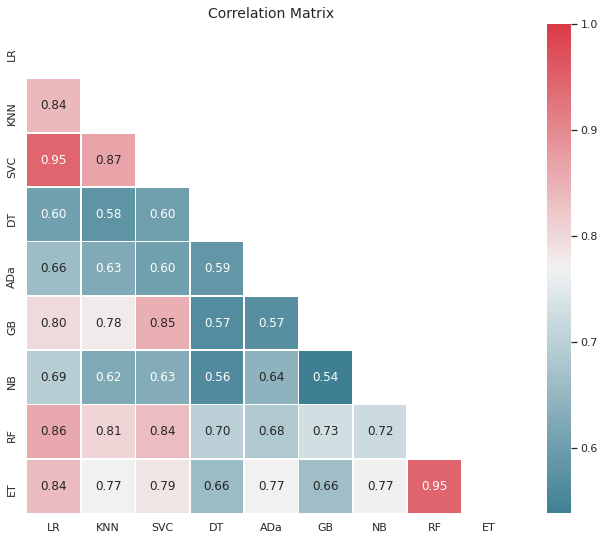

In [ ]:
corrmat(P.corr(), inflate=False)

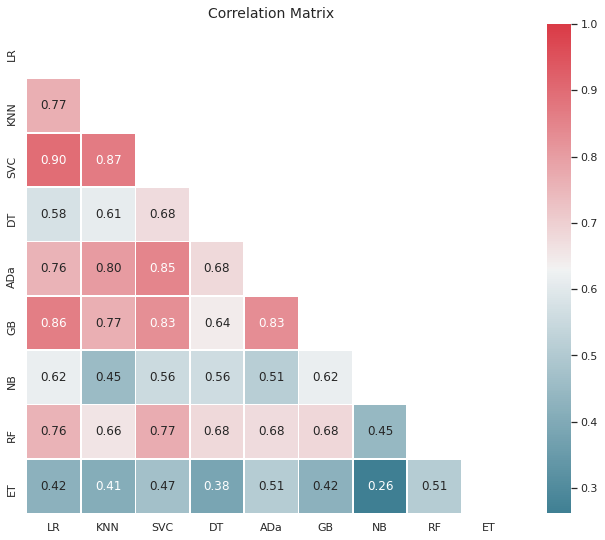

In [ ]:
corrmat(P.apply(lambda predic: 1*(predic >= 0.5) - y_test_sc).corr(), inflate=False)

Stacking

In [ ]:
from mlens.ensemble import SuperLearner

In [ ]:
base_learners = GetEnsembleModel()
meta_learner = GradientBoostingClassifier(n_estimators=1500, loss='exponential', max_features=6, max_depth=3, subsample=0.5, learning_rate=0.005, random_state=SEED)

In [ ]:
superlearner = SuperLearner(folds=10, random_state=SEED, verbose=2, backend='multiprocessing')

models = []
for name, model in base_learners:
  models.append(model)

superlearner.add(list(models), proba=True)
superlearner.add_meta(meta_learner, proba=True)

superlearner.fit(X_train_sc, y_train_sc)
superlearner_prediction = superlearner.predict_proba(X_test_sc)


Fitting 2 layers
Processing layer-1             done | 00:00:01
Processing layer-2             done | 00:00:02
Fit complete                        | 00:00:04

Predicting 2 layers
Processing layer-1             done | 00:00:00
Processing layer-2             done | 00:00:00
Predict complete                    | 00:00:00


In [ ]:
pp = []
for p in superlearner_prediction[:, 1]:
    if p > 0.5:
        pp.append(1.)
    else:
        pp.append(0.)

In [ ]:
print('Super Learner Accuracy score: %.8f' % (y_test_sc == pp).mean())

Super Learner Accuracy score: 0.87878788
